In [1]:
import pandas as pd
import yfinance as yf
import plotly.express as px
from copy import copy
from scipy import stats
import matplotlib.pyplot as plt
import numpy as np
import plotly.figure_factory as ff
from sklearn.linear_model import LinearRegression
from sklearn.svm import SVR
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
from tensorflow import keras

In [2]:
start_date = "2012-01-01"
end_date = "2023-04-30"

In [4]:
tickers = [
    "RELIANCE.NS", "TCS.NS", "INFY.NS", "ITC.NS", "HINDUNILVR.NS", 
"KOTAKBANK.NS", "SBIN.NS", "ASIANPAINT.NS", "LT.NS", "BHARTIARTL.NS", 
"TECHM.NS", "SUNPHARMA.NS", "CIPLA.NS", "ULTRACEMCO.NS", "DRREDDY.NS", "TITAN.NS", "MARUTI.NS", "HINDZINC.NS", "GRASIM.NS", "UPL.NS", "EICHERMOT.NS", 
"MRF.NS", "SHREECEM.NS", "POWERGRID.NS", "JSWSTEEL.NS", "ADANIPORTS.NS", "NTPC.NS", 
"APOLLOHOSP.NS", "INDUSINDBK.NS", "AXISBANK.NS", "M&M.NS", 
"TATAMOTORS.NS", "WIPRO.NS", "GAIL.NS", "ZEEL.NS"
]

stock_price_df = pd.DataFrame()
for ticker in tickers:
    data = yf.download(ticker, start=start_date, end=end_date)["Adj Close"]
    stock_price_df[ticker] = data

stock_price_df=stock_price_df.dropna()

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%*******

In [5]:
tickers = [
    "RELIANCE.NS", "TCS.NS", "INFY.NS", "ITC.NS", "HINDUNILVR.NS", 
"KOTAKBANK.NS", "SBIN.NS", "ASIANPAINT.NS", "LT.NS", "BHARTIARTL.NS", 
"TECHM.NS", "SUNPHARMA.NS", "CIPLA.NS", "ULTRACEMCO.NS", "DRREDDY.NS", "TITAN.NS", "MARUTI.NS", "HINDZINC.NS", "GRASIM.NS", "UPL.NS", "EICHERMOT.NS", 
"MRF.NS", "SHREECEM.NS", "POWERGRID.NS", "JSWSTEEL.NS", "ADANIPORTS.NS", "NTPC.NS", 
"APOLLOHOSP.NS", "INDUSINDBK.NS", "AXISBANK.NS", "M&M.NS", 
"TATAMOTORS.NS", "WIPRO.NS", "GAIL.NS", "ZEEL.NS"
]

stock_vol_df = pd.DataFrame()
for ticker in tickers:
    data = yf.download(ticker, start=start_date, end=end_date)["Volume"]
    stock_vol_df[ticker] = data

stock_vol_df=stock_vol_df.dropna()

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%*******

In [6]:
stock_price_df.isnull().sum()

RELIANCE.NS      0
TCS.NS           0
INFY.NS          0
ITC.NS           0
HINDUNILVR.NS    0
KOTAKBANK.NS     0
SBIN.NS          0
ASIANPAINT.NS    0
LT.NS            0
BHARTIARTL.NS    0
TECHM.NS         0
SUNPHARMA.NS     0
CIPLA.NS         0
ULTRACEMCO.NS    0
DRREDDY.NS       0
TITAN.NS         0
MARUTI.NS        0
HINDZINC.NS      0
GRASIM.NS        0
UPL.NS           0
EICHERMOT.NS     0
MRF.NS           0
SHREECEM.NS      0
POWERGRID.NS     0
JSWSTEEL.NS      0
ADANIPORTS.NS    0
NTPC.NS          0
APOLLOHOSP.NS    0
INDUSINDBK.NS    0
AXISBANK.NS      0
M&M.NS           0
TATAMOTORS.NS    0
WIPRO.NS         0
GAIL.NS          0
ZEEL.NS          0
dtype: int64

In [7]:
stock_vol_df.isnull().sum()

RELIANCE.NS      0
TCS.NS           0
INFY.NS          0
ITC.NS           0
HINDUNILVR.NS    0
KOTAKBANK.NS     0
SBIN.NS          0
ASIANPAINT.NS    0
LT.NS            0
BHARTIARTL.NS    0
TECHM.NS         0
SUNPHARMA.NS     0
CIPLA.NS         0
ULTRACEMCO.NS    0
DRREDDY.NS       0
TITAN.NS         0
MARUTI.NS        0
HINDZINC.NS      0
GRASIM.NS        0
UPL.NS           0
EICHERMOT.NS     0
MRF.NS           0
SHREECEM.NS      0
POWERGRID.NS     0
JSWSTEEL.NS      0
ADANIPORTS.NS    0
NTPC.NS          0
APOLLOHOSP.NS    0
INDUSINDBK.NS    0
AXISBANK.NS      0
M&M.NS           0
TATAMOTORS.NS    0
WIPRO.NS         0
GAIL.NS          0
ZEEL.NS          0
dtype: int64

In [8]:
stock_price_df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2792 entries, 2012-01-02 to 2023-04-28
Data columns (total 35 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   RELIANCE.NS    2792 non-null   float64
 1   TCS.NS         2792 non-null   float64
 2   INFY.NS        2792 non-null   float64
 3   ITC.NS         2792 non-null   float64
 4   HINDUNILVR.NS  2792 non-null   float64
 5   KOTAKBANK.NS   2792 non-null   float64
 6   SBIN.NS        2792 non-null   float64
 7   ASIANPAINT.NS  2792 non-null   float64
 8   LT.NS          2792 non-null   float64
 9   BHARTIARTL.NS  2792 non-null   float64
 10  TECHM.NS       2792 non-null   float64
 11  SUNPHARMA.NS   2792 non-null   float64
 12  CIPLA.NS       2792 non-null   float64
 13  ULTRACEMCO.NS  2792 non-null   float64
 14  DRREDDY.NS     2792 non-null   float64
 15  TITAN.NS       2792 non-null   float64
 16  MARUTI.NS      2792 non-null   float64
 17  HINDZINC.NS    2792 non-null   flo

In [9]:
stock_vol_df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2792 entries, 2012-01-02 to 2023-04-28
Data columns (total 35 columns):
 #   Column         Non-Null Count  Dtype
---  ------         --------------  -----
 0   RELIANCE.NS    2792 non-null   int64
 1   TCS.NS         2792 non-null   int64
 2   INFY.NS        2792 non-null   int64
 3   ITC.NS         2792 non-null   int64
 4   HINDUNILVR.NS  2792 non-null   int64
 5   KOTAKBANK.NS   2792 non-null   int64
 6   SBIN.NS        2792 non-null   int64
 7   ASIANPAINT.NS  2792 non-null   int64
 8   LT.NS          2792 non-null   int64
 9   BHARTIARTL.NS  2792 non-null   int64
 10  TECHM.NS       2792 non-null   int64
 11  SUNPHARMA.NS   2792 non-null   int64
 12  CIPLA.NS       2792 non-null   int64
 13  ULTRACEMCO.NS  2792 non-null   int64
 14  DRREDDY.NS     2792 non-null   int64
 15  TITAN.NS       2792 non-null   int64
 16  MARUTI.NS      2792 non-null   int64
 17  HINDZINC.NS    2792 non-null   int64
 18  GRASIM.NS      2792 non-null  

In [10]:
stock_vol_df.describe()

,RELIANCE.NS,TCS.NS,INFY.NS,ITC.NS,HINDUNILVR.NS,KOTAKBANK.NS,SBIN.NS,ASIANPAINT.NS,LT.NS,BHARTIARTL.NS,...,ADANIPORTS.NS,NTPC.NS,APOLLOHOSP.NS,INDUSINDBK.NS,AXISBANK.NS,M&M.NS,TATAMOTORS.NS,WIPRO.NS,GAIL.NS,ZEEL.NS
count,2.792000e+03,2.792000e+03,2.792000e+03,2.792000e+03,2.792000e+03,2.792000e+03,2.792000e+03,2.792000e+03,2.792000e+03,2.792000e+03,...,2.792000e+03,2.792000e+03,2.792000e+03,2.792000e+03,2.792000e+03,2.792000e+03,2.792000e+03,2.792000e+03,2.792000e+03,2.792000e+03
mean,9.110149e+06,2.719384e+06,8.673294e+06,1.472029e+07,1.797208e+06,2.579564e+06,2.540608e+07,1.252097e+06,3.084670e+06,8.311747e+06,...,4.798644e+06,1.062916e+07,5.128595e+05,4.022010e+06,1.140792e+07,3.114248e+06,2.109160e+07,5.929531e+06,1.341311e+07,7.998618e+06
std,6.450342e+06,2.330120e+06,8.057930e+06,1.260788e+07,3.789669e+06,3.192243e+06,2.031238e+07,9.207210e+05,1.996785e+06,1.032179e+07,...,6.604946e+06,1.200818e+07,7.005069e+05,7.290575e+06,9.757512e+06,2.344251e+06,2.877701e+07,6.656596e+06,1.208517e+07,1.387578e+07
min,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,5.492689e+06,1.665834e+06,5.290595e+06,7.875545e+06,9.656492e+05,1.255702e+06,1.384560e+07,7.028410e+05,1.846772e+06,3.589467e+06,...,1.980852e+06,3.965600e+06,1.583728e+05,8.716108e+05,5.996458e+06,1.680112e+06,6.526751e+06,2.958705e+06,6.211690e+06,1.564917e+06
50%,7.359921e+06,2.279726e+06,6.966764e+06,1.073802e+07,1.404120e+06,1.921424e+06,1.900137e+07,1.001020e+06,2.530270e+06,5.479877e+06,...,3.201682e+06,7.093516e+06,3.175255e+05,1.663138e+06,8.550675e+06,2.431655e+06,1.044677e+07,4.355428e+06,1.011380e+07,2.870061e+06
75%,1.032487e+07,3.158939e+06,9.605249e+06,1.679919e+07,2.008653e+06,3.003940e+06,2.893361e+07,1.507891e+06,3.679399e+06,9.267766e+06,...,5.255409e+06,1.262449e+07,6.223132e+05,3.603954e+06,1.280054e+07,3.767136e+06,2.198744e+07,6.668087e+06,1.627119e+07,9.044644e+06
max,7.134168e+07,8.806715e+07,1.663204e+08,1.494797e+08,1.856699e+08,8.385990e+07,2.626771e+08,1.154592e+07,2.115335e+07,1.985470e+08,...,1.155175e+08,2.169817e+08,1.149133e+07,8.133499e+07,1.205419e+08,3.298648e+07,3.905778e+08,1.303676e+08,1.720730e+08,2.186002e+08


In [11]:
def normalize(df):
    x = df.copy()

    for column in x.columns[0:]:
        x[column] = x[column]/x[column][0]

    return x

In [12]:
def interactive_plot(df, title):
    fig = px.line(title=title)

    for column in df.columns[0:]:
        fig.add_scatter(x=df.index, y=df[column], name=column)

    fig.show()

In [14]:
interactive_plot(stock_price_df, 'Stock Prices')

In [15]:
def individual_stock(price_df, vol_df, name):
    stock_df = pd.DataFrame({
        'Close': price_df[name],
        'Volume': vol_df[name]
    })

    return stock_df

In [16]:
def trading_window(data):
    n = 1
    data['Target'] = data['Close'].shift(-n)
    return data

In [17]:
price_volume_df = individual_stock(stock_price_df, stock_vol_df, 'ITC.NS')
price_volume_df

,Close,Volume
Date,,
2012-01-02,95.099304,2860839
2012-01-03,95.913116,6065590
2012-01-04,95.530159,11875083
2012-01-05,95.649826,11364489
2012-01-06,96.750900,8788212
...,...,...
2023-04-24,393.341400,5981760
2023-04-25,396.084259,8840188
2023-04-26,396.757935,7620723


In [18]:
price_volume_target_df = trading_window(price_volume_df)
price_volume_target_df

,Close,Volume,Target
Date,,,
2012-01-02,95.099304,2860839,95.913116
2012-01-03,95.913116,6065590,95.530159
2012-01-04,95.530159,11875083,95.649826
2012-01-05,95.649826,11364489,96.750900
2012-01-06,96.750900,8788212,96.703033
...,...,...,...
2023-04-24,393.341400,5981760,396.084259
2023-04-25,396.084259,8840188,396.757935
2023-04-26,396.757935,7620723,400.367035


In [19]:
price_volume_target_df = price_volume_target_df[:-1]
price_volume_target_df

,Close,Volume,Target
Date,,,
2012-01-02,95.099304,2860839,95.913116
2012-01-03,95.913116,6065590,95.530159
2012-01-04,95.530159,11875083,95.649826
2012-01-05,95.649826,11364489,96.750900
2012-01-06,96.750900,8788212,96.703033
...,...,...,...
2023-04-21,392.908264,14252204,393.341400
2023-04-24,393.341400,5981760,396.084259
2023-04-25,396.084259,8840188,396.757935


In [20]:
from sklearn.preprocessing import MinMaxScaler

def scale_data(df):
    sc = MinMaxScaler(feature_range = (0, 1))
    scaled_array = sc.fit_transform(df)

    return scaled_array

In [21]:
price_volume_target_scaled_df  = scale_data(price_volume_target_df)
price_volume_target_scaled_df

array([[0.00000000e+00, 1.91386480e-02, 1.98032839e-03],
       [2.66589677e-03, 4.05780234e-02, 7.61756271e-04],
       [1.41139975e-03, 7.94427906e-02, 1.14253730e-03],
       ...,
       [9.85970427e-01, 5.91397302e-02, 9.59269709e-01],
       [9.88177262e-01, 5.09816649e-02, 9.70753881e-01],
       [1.00000000e+00, 8.43878105e-02, 1.00000000e+00]])

In [22]:
price_volume_target_scaled_df.shape

(2791, 3)

In [23]:
X = price_volume_target_scaled_df[:,:2]
y = price_volume_target_scaled_df[:,2:]

In [25]:
X = np.asarray(X)
y = np.asarray(y)
X.shape, y.shape

((2791, 2), (2791, 1))

In [29]:
split = int(0.80 * len(X))
X_train = X[:split]
y_train = y[:split]
X_test = X[split:]
y_test = y[split:]

In [30]:
X_train.shape, y_train.shape

((2232, 2), (2232, 1))

In [31]:
X_test.shape, y_test.shape

((559, 2), (559, 1))

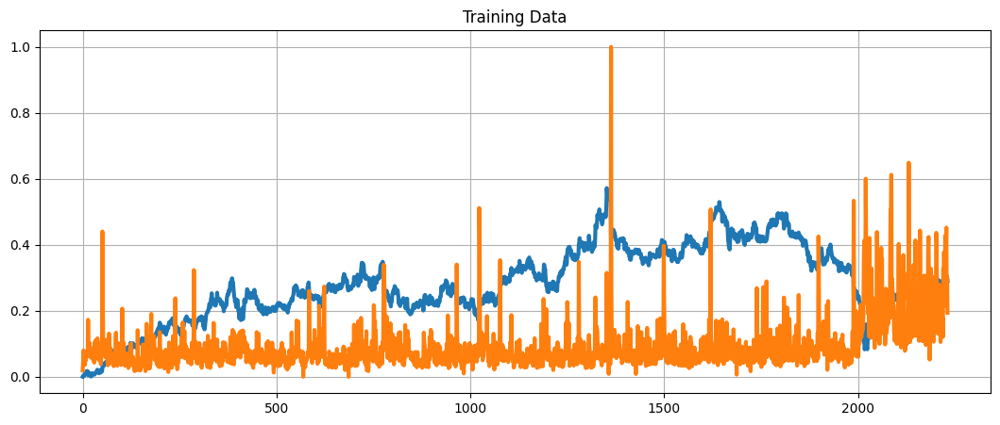

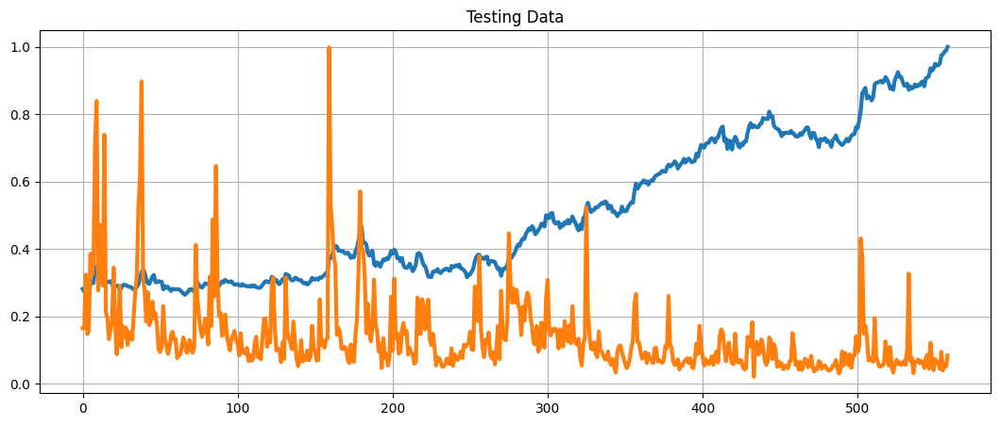

In [34]:
def show_plot(data, title):
    plt.figure(figsize = (13, 5))
    plt.plot(data, linewidth = 3)
    plt.title(title)
    plt.grid()
    plt.show()

show_plot(X_train, 'Training Data')
show_plot(X_test, 'Testing Data')

MODEL

In [37]:
from sklearn.linear_model import Ridge
regression_model = Ridge()
regression_model.fit(X_train, y_train)

Ridge()

In [38]:
lr_accuracy = regression_model.score(X_test, y_test)
print("Linear Regression Score: ", lr_accuracy)

Linear Regression Score:  0.9932423031388665


In [39]:
predicted_prices = regression_model.predict(X)
predicted_prices

array([[0.00960542],
       [0.01215699],
       [0.01109479],
       ...,
       [0.93097367],
       [0.93301257],
       [0.94415382]])

In [40]:
Predicted = []
for i in predicted_prices:
  Predicted.append(i[0])

In [41]:
len(Predicted)

2791

In [42]:
close = []
for i in price_volume_target_scaled_df:
  close.append(i[0])

In [49]:
df_predicted = price_volume_target_df[['Close']]
df_predicted['Close'] = close
df_predicted

,Close
Date,
2012-01-02,0.000000
2012-01-03,0.002666
2012-01-04,0.001411
2012-01-05,0.001803
2012-01-06,0.005410
...,...
2023-04-21,0.975566
2023-04-24,0.976985
2023-04-25,0.985970


In [50]:
df_predicted['Prediction'] = Predicted
df_predicted

,Close,Prediction
Date,,
2012-01-02,0.000000,0.009605
2012-01-03,0.002666,0.012157
2012-01-04,0.001411,0.011095
2012-01-05,0.001803,0.011451
2012-01-06,0.005410,0.014773
...,...,...
2023-04-21,0.975566,0.921355
2023-04-24,0.976985,0.922524
2023-04-25,0.985970,0.930974


In [51]:
interactive_plot(df_predicted, "Original Vs. Prediction")

LSTM

In [52]:
price_volume_df = individual_stock(stock_price_df, stock_vol_df, 'RELIANCE.NS')
price_volume_df

,Close,Volume
Date,,
2012-01-02,294.166199,9404053
2012-01-03,301.701965,10244609
2012-01-04,298.163086,9270951
2012-01-05,291.230988,14479600
2012-01-06,298.745941,10287605
...,...,...
2023-04-24,2168.772217,6468093
2023-04-25,2185.373535,4618063
2023-04-26,2172.543213,4308917


In [54]:
training_data = price_volume_df.iloc[:, 0:2].values
training_data

array([[2.94166199e+02, 9.40405300e+06],
       [3.01701965e+02, 1.02446090e+07],
       [2.98163086e+02, 9.27095100e+06],
       ...,
       [2.17254321e+03, 4.30891700e+06],
       [2.18629346e+03, 4.58356200e+06],
       [2.22625659e+03, 7.78260500e+06]])

In [55]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_data)

In [56]:
X = []
y = []
for i in range(1, len(price_volume_df)):
    X.append(training_set_scaled [i-1:i, 0])
    y.append(training_set_scaled [i, 0])

In [57]:
X = np.asarray(X)
y = np.asarray(y)

In [59]:
split = int(0.8 * len(X))
X_train = X[:split]
y_train = y[:split]
X_test = X[split:]
y_test = y[split:]

In [60]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))
X_train.shape, X_test.shape

((2232, 1, 1), (559, 1, 1))

In [61]:
inputs = keras.layers.Input(shape=(X_train.shape[1], X_train.shape[2]))
x = keras.layers.LSTM(150, return_sequences= True)(inputs)
x = keras.layers.Dropout(0.3)(x)
x = keras.layers.LSTM(150, return_sequences=True)(x)
x = keras.layers.Dropout(0.3)(x)
x = keras.layers.LSTM(150)(x)
outputs = keras.layers.Dense(1, activation='linear')(x)

model = keras.Model(inputs=inputs, outputs=outputs)
model.compile(optimizer='adam', loss="mse")
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 1, 1)]            0         
                                                                 
 lstm (LSTM)                 (None, 1, 150)            91200     
                                                                 
 dropout (Dropout)           (None, 1, 150)            0         
                                                                 
 lstm_1 (LSTM)               (None, 1, 150)            180600    
                                                                 
 dropout_1 (Dropout)         (None, 1, 150)            0         
                                                                 
 lstm_2 (LSTM)               (None, 150)               180600    
                                                                 
 dense (Dense)               (None, 1)                 151   

In [62]:
history = model.fit(
    X_train, y_train,
    epochs = 20,
    batch_size = 32,
    validation_split = 0.2
)

Epoch 1/20
56/56 [==============================] - 6s 22ms/step - loss: 0.0088 - val_loss: 0.0077
Epoch 2/20
56/56 [==============================] - 0s 6ms/step - loss: 2.6656e-04 - val_loss: 6.6926e-04
Epoch 3/20
56/56 [==============================] - 0s 6ms/step - loss: 1.1582e-04 - val_loss: 3.4119e-04
Epoch 4/20
56/56 [==============================] - 0s 6ms/step - loss: 1.1714e-04 - val_loss: 3.4208e-04
Epoch 5/20
56/56 [==============================] - 0s 6ms/step - loss: 1.0914e-04 - val_loss: 2.1522e-04
Epoch 6/20
56/56 [==============================] - 0s 8ms/step - loss: 1.0283e-04 - val_loss: 4.2052e-04
Epoch 7/20
56/56 [==============================] - 0s 7ms/step - loss: 9.1487e-05 - val_loss: 2.7260e-04
Epoch 8/20
56/56 [==============================] - 0s 8ms/step - loss: 1.0492e-04 - val_loss: 4.4260e-04
Epoch 9/20
56/56 [==============================] - 0s 6ms/step - loss: 1.0349e-04 - val_loss: 2.7609e-04
Epoch 10/20
56/56 [==============================] - 

In [63]:
predicted = model.predict(X)

88/88 [==============================] - 1s 2ms/step


In [64]:
predicted

array([[0.00518957],
       [0.00854105],
       [0.00696723],
       ...,
       [0.7975725 ],
       [0.7927025 ],
       [0.79792136]], dtype=float32)

In [65]:
test_predicted = []

for i in predicted:
  test_predicted.append(i[0])

In [66]:
test_predicted

[0.005189566,
 0.008541047,
 0.006967229,
 0.0038839765,
 0.0072264485,
 0.005133994,
 0.010679346,
 0.012909947,
 0.0108089475,
 0.0098648,
 0.0063746823,
 0.011762291,
 0.018739618,
 0.01983127,
 0.021126403,
 0.017222254,
 0.019479763,
 0.020811904,
 0.026259568,
 0.02151492,
 0.025649235,
 0.028256923,
 0.0278963,
 0.029569857,
 0.028589789,
 0.030725501,
 0.033286124,
 0.032444954,
 0.030485144,
 0.031594504,
 0.03152979,
 0.029264744,
 0.024789182,
 0.025852727,
 0.030540612,
 0.028663773,
 0.029810239,
 0.026176382,
 0.019054182,
 0.021838669,
 0.026324347,
 0.024511715,
 0.025094356,
 0.022023696,
 0.018147487,
 0.0154179055,
 0.017638603,
 0.022217935,
 0.026176382,
 0.025168352,
 0.021866407,
 0.017370291,
 0.014177842,
 0.015186553,
 0.01657456,
 0.010707108,
 0.012132512,
 0.009550071,
 0.009725981,
 0.008735435,
 0.008541047,
 0.013344962,
 0.011484621,
 0.013733678,
 0.012678562,
 0.01178082,
 0.011873368,
 0.009587091,
 0.011993679,
 0.013520778,
 0.012882216,
 0.0125675

In [67]:
df_predicted = price_volume_df[1:][['Close']]
df_predicted

,Close
Date,
2012-01-03,301.701965
2012-01-04,298.163086
2012-01-05,291.230988
2012-01-06,298.745941
2012-01-09,294.041260
...,...
2023-04-24,2168.772217
2023-04-25,2185.373535
2023-04-26,2172.543213


In [68]:
df_predicted['predictions'] = test_predicted
df_predicted

,Close,predictions
Date,,
2012-01-03,301.701965,0.005190
2012-01-04,298.163086,0.008541
2012-01-05,291.230988,0.006967
2012-01-06,298.745941,0.003884
2012-01-09,294.041260,0.007226
...,...,...
2023-04-24,2168.772217,0.788121
2023-04-25,2185.373535,0.791269
2023-04-26,2172.543213,0.797572


In [69]:
df_predicted= df_predicted.drop('Close', axis=1)
df_predicted

,predictions
Date,
2012-01-03,0.005190
2012-01-04,0.008541
2012-01-05,0.006967
2012-01-06,0.003884
2012-01-09,0.007226
...,...
2023-04-24,0.788121
2023-04-25,0.791269
2023-04-26,0.797572


In [70]:
close = []
for i in training_set_scaled:
  close.append(i[0])

In [72]:
df_predicted['Close'] = close[1:]

In [73]:
df_predicted

,predictions,Close
Date,,
2012-01-03,0.005190,0.008775
2012-01-04,0.008541,0.007238
2012-01-05,0.006967,0.004229
2012-01-06,0.003884,0.007491
2012-01-09,0.007226,0.005449
...,...,...
2023-04-24,0.788121,0.819263
2023-04-25,0.791269,0.826470
2023-04-26,0.797572,0.820900


In [74]:
interactive_plot(df_predicted, "Original Vs Prediction")

In [75]:
interactive_plot(stock_vol_df, 'Stocks Volume')

In [76]:
interactive_plot(normalize(stock_price_df), 'Stock Prices')
interactive_plot(normalize(stock_vol_df), 'Normalized Volume')